In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import train_test_split
from PIL import Image
import rampy
from BaselineRemoval import BaselineRemoval
%matplotlib inline
%config InlineBackend.figure_fornat = 'retina'
pd.set_option('display.max_rows',5000)
pd.set_option('display.max_columns',5000)

In [2]:
df = pd.read_csv('D-Tyrosine_all.csv')
df1 = pd.read_csv('L-(-)-Tyrosine_all.csv')

In [3]:
df=df.drop('Unnamed: 0',axis=1)
df.head()

,Wave Number0,Intensity0,Wave Number1,Intensity1,Wave Number2,Intensity2,Wave Number3,Intensity3,Wave Number4,Intensity4,Wave Number5,Intensity5,Wave Number6,Intensity6,Wave Number7,Intensity7,Wave Number8,Intensity8,Wave Number9,Intensity9,Wave Number10,Intensity10,Wave Number11,Intensity11,Wave Number12,Intensity12,Wave Number13,Intensity13,Wave Number14,Intensity14,Wave Number15,Intensity15,Wave Number16,Intensity16,Wave Number17,Intensity17,Wave Number18,Intensity18,Wave Number19,Intensity19,Wave Number20,Intensity20,Wave Number21,Intensity21,Wave Number22,Intensity22,Wave Number23,Intensity23,Wave Number24,Intensity24,Wave Number25,Intensity25,Wave Number26,Intensity26,Wave Number27,Intensity27,Wave Number28,Intensity28,Wave Number29,Intensity29,Wave Number30,Intensity30,Wave Number31,Intensity31,Wave Number32,Intensity32,Wave Number33,Intensity33,Wave Number34,Intensity34,Wave Number35,Intensity35,Wave Number36,Intensity36,Wave Number37,Intensity37,Wave Number38,Intensity38,Wave Number39,Intensity39,Wave Number40,Intensity40,Wave Number41,Intensity41,Wave Number42,Intensity42,Wave Number43,Intensity43,Wave Number44,Intensity44,Wave Number45,Intensity45,Wave Number46,Intensity46,Wave Number47,Intensity47,Wave Number48,Intensity48,Wave Number49,Intensity49,Wave Number50,Intensity50,Wave Number51,Intensity51,Wave Number52,Intensity52,Wave Number53,Intensity53,Wave Number54,Intensity54,Wave Number55,Intensity55,Wave Number56,Intensity56,Wave Number57,Intensity57,Wave Number58,Intensity58,Wave Number59,Intensity59,Wave Number60,Intensity60,Wave Number61,Intensity61,Wave Number62,Intensity62,Wave Number63,Intensity63,Wave Number64,Intensity64,Wave Number65,Intensity65,Wave Number66,Intensity66,Wave Number67,Intensity67,Wave Number68,Intensity68,Wave Number69,Intensity69,Wave Number70,Intensity70,Wave Number71,Intensity71,Wave Number72,Intensity72,Wave Number73,Intensity73,Wave Number74,Intensity74,Wave Number75,Intensity75,Wave Number76,Intensity76,Wave Number77,Intensity77,Wave Number78,Intensity78,Wave Number79,Intensity79,Wave Number80,Intensity80,Wave Number81,Intensity81,Wave Number82,Intensity82,Wave Number83,Intensity83,Wave Number84,Intensity84,Wave Number85,Intensity85,Wave Number86,Intensity86,Wave Number87,Intensity87,Wave Number88,Intensity88,Wave Number89,Intensity89,Wave Number90,Intensity90,Wave Number91,Intensity91,Wave Number92,Intensity92,Wave Number93,Intensity93,Wave Number94,Intensity94,Wave Number95,Intensity95,Wave Number96,Intensity96,Wave Number97,Intensity97,Wave Number98,Intensity98,Wave Number99,Intensity99,Wave Number100,Intensity100,Wave Number101,Intensity101,Wave Number102,Intensity102,Wave Number103,Intensity103,Wave Number104,Intensity104,Wave Number105,Intensity105,Wave Number106,Intensity106,Wave Number107,Intensity107,Wave Number108,Intensity108,Wave Number109,Intensity109,Wave Number110,Intensity110,Wave Number111,Intensity111,Wave Number112,Intensity112,Wave Number113,Intensity113,Wave Number114,Intensity114
0,399.45391,1.42139,399.45391,1.39645,399.45391,1.48092,399.45391,1.45504,399.45391,1.47252,399.45391,1.45080,399.45391,1.45564,399.45391,1.46872,399.45391,1.46627,399.45391,1.51097,399.45391,1.46379,399.45391,1.62166,399.45391,1.65027,399.45391,1.69551,399.45391,1.65769,399.45391,1.53682,399.45391,1.77313,399.45391,1.61531,399.45391,1.59106,399.45391,1.61045,399.45391,1.65486,399.45391,1.67171,399.45391,1.72327,399.45391,1.64743,399.45391,1.64807,399.45391,1.64546,399.45391,1.48919,399.45391,1.48022,399.45391,1.51109,399.45391,1.63020,399.45391,1.45307,399.45391,1.45741,399.45391,1.43911,399.45391,1.46861,399.45391,1.50932,399.45391,1.47290,399.45391,1.47013,399.45391,1.67273,399.45391,1.60830,399.45391,1.39473,399.45391,1.44968,399.45391,1.43754,399.45391,1.44423,399.45391,1.44318,399.45391,1.43503,399.45391,1.39377,399.45391,1.45352,399.45391,1.42968,399.45391,1.43324,399.45391,1.71500,399.45391,1.72168,399.45391,2.09433,399.45391,1.92579,399.45391,1.80363,399.45391,1.89451,399.453

In [36]:
df.iloc[0:1,:]

,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness
0,399.45391,1.42139,399.45391,1.39645,399.45391,1.48092,399.45391,1.45504,399.45391,1.47252,399.45391,1.4508,399.45391,1.45564,399.45391,1.46872,399.45391,1.46627,399.45391,1.51097,399.45391,1.46379,399.45391,1.62166,399.45391,1.65027,399.45391,1.69551,399.45391,1.65769,399.45391,1.53682,399.45391,1.77313,399.45391,1.61531,399.45391,1.59106,399.45391,1.61045,399.45391,1.65486,399.45391,1.67171,399.45391,1.72327,399.45391,1.64743,399.45391,1.64807,399.45391,1.64546,399.45391,1.48919,399.45391,1.48022,399.45391,1.51109,399.45391,1.6302,399.45391,1.45307,399.45391,1.45741,399.45391,1.43911,399.45391,1.46861,399.45391,1.50932,399.45391,1.4729,399.45391,1.47013,399.45391,1.67273,399.45391,1.6083,399.45391,1.39473,399.45391,1.44968,399.45391,1.43754,399.45391,1.44423,399.45391,1.44318,399.45391,1.43503,399.45391,1.39377,399.45391,1.45352,399.45391,1.42968,399.45391,1.43324,399.45391,1.715,399.45391,1.72168,399.45391,2.09433,399.45391,1.92579,399.45391,1.80363,399.45391,1.89451,399.45391,1.80067,399.45391,1.85123,399.45391,1.65814,399.45391,1.8221,399.45391,2.13321,399.45391,1.78529,399.45391,1.56325,399.45391,1.54664,399.45391,1.5512,399.45391,1.87396,399.45391,1.57024,399.45391,1.55526,399.45391,1.58011,399.45391,1.5095,399.45391,1.56124,399.45391,1.55047,399.45391,1.53704,399.45391,1.42149,399.45391,1.46017,399.45391,1.45372,399.45391,1

In [15]:
new = []
for i in range(0,1659,1):
    Hf=df.iloc[2*i:2*i+1,:]
    new.append(Hf)
new_arr = np.array(new)
new_arr[1::2]

array([   Wave Number0  Intensity0  Wave Number1  Intensity1  Wave Number2  \
2     398.97177     1.42339     398.97177     1.39146     398.97177   

   Intensity2  Wave Number3  Intensity3  Wave Number4  Intensity4  \
2     1.48422     398.97177     1.48369     398.97177     1.46907   

   Wave Number5  Intensity5  Wave Number6  Intensity6  Wave Number7  \
2     398.97177     1.47597     398.97177     1.45231     398.97177   

   Intensity7  Wave Number8  Intensity8  Wave Number9  Intensity9  \
2     1.44922     398.97177     1.48612     398.97177     1.49697   

   Wave Number10  Intensity10  Wave Number11  Intensity11  Wave Number12  \
2      398.97177      1.45463      398.97177      1.64349      398.97177   

   Intensity12  Wave Number13  Intensity13  Wave Number14  Intensity14  \
2      1.66542      398.97177      1.72705      398.97177      1.66895   

   Wave Number15  Intensity15  Wave Number16  Intensity16  Wave Number17  \
2      398.97177      1.66672      398.97177       

In [4]:
df.rename(columns = { i: "NumberWave" for i in  df.columns if i.startswith("Wave") },inplace=True)
df.rename(columns = { i: "Intenseness" for i in  df.columns if i.startswith("Inten") },inplace=True)

In [54]:
df.iloc[2+1,:]

Wave Number0      398.73070
Intensity0          1.41679
Wave Number1      398.73070
Intensity1          1.40050
Wave Number2      398.73070
Intensity2          1.48614
Wave Number3      398.73070
Intensity3          1.48833
Wave Number4      398.73070
Intensity4          1.46281
Wave Number5      398.73070
Intensity5          1.47445
Wave Number6      398.73070
Intensity6          1.45335
Wave Number7      398.73070
Intensity7          1.45366
Wave Number8      398.73070
Intensity8          1.49502
Wave Number9      398.73070
Intensity9          1.48052
Wave Number10     398.73070
Intensity10         1.45434
Wave Number11     398.73070
Intensity11         1.64659
Wave Number12     398.73070
Intensity12         1.66461
Wave Number13     398.73070
Intensity13         1.74386
Wave Number14     398.73070
Intensity14         1.68493
Wave Number15     398.73070
Intensity15         1.71199
Wave Number16     398.73070
Intensity16         1.62703
Wave Number17     398.73070
Intensity17         

In [65]:
data_all = []
for i in range(115):
    df_tmp=df.iloc[:,2*i+1]
    data_all.append(df_tmp)
data_all = np.vstack(data_all)

array([1.42139, 1.39645, 1.48092, 1.45504, 1.47252, 1.4508 , 1.45564,
       1.46872, 1.46627, 1.51097, 1.46379, 1.62166, 1.65027, 1.69551,
       1.65769, 1.53682, 1.77313, 1.61531, 1.59106, 1.61045, 1.65486,
       1.67171, 1.72327, 1.64743, 1.64807, 1.64546, 1.48919, 1.48022,
       1.51109, 1.6302 , 1.45307, 1.45741, 1.43911, 1.46861, 1.50932,
       1.4729 , 1.47013, 1.67273, 1.6083 , 1.39473, 1.44968, 1.43754,
       1.44423, 1.44318, 1.43503, 1.39377, 1.45352, 1.42968, 1.43324,
       1.715  , 1.72168, 2.09433, 1.92579, 1.80363, 1.89451, 1.80067,
       1.85123, 1.65814, 1.8221 , 2.13321, 1.78529, 1.56325, 1.54664,
       1.5512 , 1.87396, 1.57024, 1.55526, 1.58011, 1.5095 , 1.56124,
       1.55047, 1.53704, 1.42149, 1.46017, 1.45372, 1.44399, 1.46701,
       1.4851 , 1.49873, 1.4752 , 1.48615, 1.51861, 1.73539, 1.92866,
       1.88302, 1.84996, 1.88153, 1.85953, 1.85463, 1.78277, 1.8064 ,
       1.8018 , 1.81558, 1.74115, 1.5722 , 1.5329 , 1.58267, 1.79249,
       1.55252, 1.55

In [ ]:
data_all = []
for i in range(1658):
    df_tmp=df.iloc[2*i+1,:]
    data_all.append(df_tmp)
data_all = np.vstack(data_all)

In [5]:
df1=df.iloc[:,0:2]
df2=df.iloc[:,2:4]
df3=df.iloc[:,4:6]
df4=df.iloc[:,6:8]
df5=df.iloc[:,8:10]
df6=df.iloc[:,10:12]
df7=df.iloc[:,12:14]
df8=df.iloc[:,14:16]
df9=df.iloc[:,16:18]
df10=df.iloc[:,18:20]
df11=df.iloc[:,20:22]
df12=df.iloc[:,22:24]
df13=df.iloc[:,24:26]
df14=df.iloc[:,26:28]
df15=df.iloc[:,28:30]
df16=df.iloc[:,30:32]
df17=df.iloc[:,32:34]
df18=df.iloc[:,34:36]
df19=df.iloc[:,36:38]
df20=df.iloc[:,38:40]
df21=df.iloc[:,40:42]
df22=df.iloc[:,42:44]
df23=df.iloc[:,44:46]
df24=df.iloc[:,46:48]
df25=df.iloc[:,48:50]
df26=df.iloc[:,50:52]
df27=df.iloc[:,52:54]
df28=df.iloc[:,54:56]
df29=df.iloc[:,56:58]
df30=df.iloc[:,58:60]
df31=df.iloc[:,60:62]
df32=df.iloc[:,62:64]
df33=df.iloc[:,64:66]
df34=df.iloc[:,66:68]
df35=df.iloc[:,68:70]
df36=df.iloc[:,70:72]
df37=df.iloc[:,72:74]
df38=df.iloc[:,74:76]
df39=df.iloc[:,76:78]
df40=df.iloc[:,78:80]
df41=df.iloc[:,80:82]
df42=df.iloc[:,82:84]
df43=df.iloc[:,84:86]
df44=df.iloc[:,86:88]
df45=df.iloc[:,88:90]
df46=df.iloc[:,90:92]
df47=df.iloc[:,92:94]
df48=df.iloc[:,94:96]
df49=df.iloc[:,96:98]
df50=df.iloc[:,98:100]
df51=df.iloc[:,100:102]
df52=df.iloc[:,102:104]
df53=df.iloc[:,104:106]
df54=df.iloc[:,106:108]
df55=df.iloc[:,108:110]
df56=df.iloc[:,110:112]
df57=df.iloc[:,112:114]
df58=df.iloc[:,114:116]
df59=df.iloc[:,116:118]
df60=df.iloc[:,118:120]
df61=df.iloc[:,120:122]
df62=df.iloc[:,122:124]
df63=df.iloc[:,124:126]
df64=df.iloc[:,126:128]
df65=df.iloc[:,128:130]
df66=df.iloc[:,130:132]
df67=df.iloc[:,132:134]
df68=df.iloc[:,134:136]
df69=df.iloc[:,136:138]
df70=df.iloc[:,138:140]
df71=df.iloc[:,140:142]
df72=df.iloc[:,142:144]
df73=df.iloc[:,144:146]
df74=df.iloc[:,146:148]
df75=df.iloc[:,148:150]
df76=df.iloc[:,150:152]
df77=df.iloc[:,152:154]
df78=df.iloc[:,154:156]
df79=df.iloc[:,156:158]
df80=df.iloc[:,158:160]
df81=df.iloc[:,160:162]
df82=df.iloc[:,162:164]
df83=df.iloc[:,164:166]
df84=df.iloc[:,166:168]
df85=df.iloc[:,168:170]
df86=df.iloc[:,170:172]
df87=df.iloc[:,172:174]
df88=df.iloc[:,174:176]
df89=df.iloc[:,176:178]
df90=df.iloc[:,178:180]
df91=df.iloc[:,180:182]
df92=df.iloc[:,182:184]
df93=df.iloc[:,184:186]
df94=df.iloc[:,186:188]
df95=df.iloc[:,188:190]
df96=df.iloc[:,190:192]
df97=df.iloc[:,192:194]
df98=df.iloc[:,194:196]
df99=df.iloc[:,196:198]
df100=df.iloc[:,198:200]
df101=df.iloc[:,200:202]
df102=df.iloc[:,202:204]
df103=df.iloc[:,204:206]
df104=df.iloc[:,206:208]
df105=df.iloc[:,208:210]
df106=df.iloc[:,210:212]
df107=df.iloc[:,212:214]
df108=df.iloc[:,214:216]
df109=df.iloc[:,216:218]
df110=df.iloc[:,218:220]
df111=df.iloc[:,220:222]
df112=df.iloc[:,222:224]
df113=df.iloc[:,224:226]
df114=df.iloc[:,226:228]
df115=df.iloc[:,228:230]

In [6]:
df_all=pd.concat([df1,df2,df3,df4,df5,df6,df7,df8,df9,df10,df11,df12,df13,df14,df15,df16,df17,df18,df19,df20,df21,df22,df23,df24,df25,df26,df27,df28,df29,df30,df31,
              df32,df33,df34,df35,df36,df37,df38,df39,df40,df41,df42,df43,df44,df45,df46,df47,df48,df49,df50,df51,df52,df53,df54,df55,df56,df4,df57,df58,df59,df60,df61,
              df62,df63,df64,df65,df66,df67,df68,df69,df70,df71,df72,df73,df74,df75,df76,df77,df78,df79,df80,df81,df82,df83,df84,df85,df86,df87,df88,df89,df90,df91,df92,df93,df94,df95,df96,df97,df98,df99,
              df100,df101,df102,df103,df104,df105,df106,df107,df108,df109,df110,df111,df112,df113,df114,df115])
df_all

,NumberWave,Intenseness
0,399.45391,1.42139
1,399.21284,1.42504
2,398.97177,1.42339
3,398.73070,1.41679
4,398.48963,1.40918
...,...,...
1653,0.96428,-0.36698
1654,0.72321,-0.39711
1655,0.48214,-0.45737
1656,0.24107,-0.43889


In [291]:
df_all.to_csv('all_DataDtyrosine.csv')

In [27]:
dfL = pd.read_csv('L-(-)-Tyrosine_all.csv')
dfL.head()

,Unnamed: 0,Wave Number0,Intensity0,Wave Number1,Intensity1,Wave Number2,Intensity2,Wave Number3,Intensity3,Wave Number4,Intensity4,Wave Number5,Intensity5,Wave Number6,Intensity6,Wave Number7,Intensity7,Wave Number8,Intensity8,Wave Number9,Intensity9,Wave Number10,Intensity10,Wave Number11,Intensity11,Wave Number12,Intensity12,Wave Number13,Intensity13,Wave Number14,Intensity14,Wave Number15,Intensity15,Wave Number16,Intensity16,Wave Number17,Intensity17,Wave Number18,Intensity18,Wave Number19,Intensity19,Wave Number20,Intensity20,Wave Number21,Intensity21,Wave Number22,Intensity22,Wave Number23,Intensity23,Wave Number24,Intensity24,Wave Number25,Intensity25,Wave Number26,Intensity26,Wave Number27,Intensity27,Wave Number28,Intensity28,Wave Number29,Intensity29,Wave Number30,Intensity30,Wave Number31,Intensity31,Wave Number32,Intensity32,Wave Number33,Intensity33,Wave Number34,Intensity34,Wave Number35,Intensity35,Wave Number36,Intensity36,Wave Number37,Intensity37,Wave Number38,Intensity38,Wave Number39,Intensity39,Wave Number40,Intensity40,Wave Number41,Intensity41,Wave Number42,Intensity42,Wave Number43,Intensity43,Wave Number44,Intensity44,Wave Number45,Intensity45,Wave Number46,Intensity46,Wave Number47,Intensity47,Wave Number48,Intensity48,Wave Number49,Intensity49,Wave Number50,Intensity50,Wave Number51,Intensity51,Wave Number52,Intensity52,Wave Number53,Intensity53,Wave Number54,Intensity54,Wave Number55,Intensity55,Wave Number56,Intensity56,Wave Number57,Intensity57,Wave Number58,Intensity58,Wave Number59,Intensity59,Wave Number60,Intensity60,Wave Number61,Intensity61,Wave Number62,Intensity62,Wave Number63,Intensity63,Wave Number64,Intensity64,Wave Number65,Intensity65,Wave Number66,Intensity66,Wave Number67,Intensity67,Wave Number68,Intensity68,Wave Number69,Intensity69,Wave Number70,Intensity70,Wave Number71,Intensity71,Wave Number72,Intensity72,Wave Number73,Intensity73,Wave Number74,Intensity74,Wave Number75,Intensity75,Wave Number76,Intensity76,Wave Number77,Intensity77,Wave Number78,Intensity78,Wave Number79,Intensity79,Wave Number80,Intensity80,Wave Number81,Intensity81,Wave Number82,Intensity82,Wave Number83,Intensity83,Wave Number84,Intensity84,Wave Number85,Intensity85,Wave Number86,Intensity86,Wave Number87,Intensity87,Wave Number88,Intensity88,Wave Number89,Intensity89,Wave Number90,Intensity90,Wave Number91,Intensity91,Wave Number92,Intensity92,Wave Number93,Intensity93,Wave Number94,Intensity94,Wave Number95,Intensity95,Wave Number96,Intensity96,Wave Number97,Intensity97,Wave Number98,Intensity98,Wave Number99,Intensity99,Wave Number100,Intensity100,Wave Number101,Intensity101,Wave Number102,Intensity102,Wave Number103,Intensity103,Wave Number104,Intensity104,Wave Number105,Intensity105,Wave Number106,Intensity106,Wave Number107,Intensity107,Wave Number108,Intensity108,Wave Number109,Intensity109,Wave Number110,Intensity110,Wave Number111,Intensity111,Wave Number112,Intensity112,Wave Number113,Intensity113,Wave Number114,Intensity114,Wave Number115,Intensity115,Wave Number116,Intensity116,Wave Number117,Intensity117,Wave Number118,Intensity118,Wave Number119,Intensity119
0,0,399.45391,1.40377,399.45391,1.40352,399.45391,1.44629,399.45391,1.45580,399.45391,1.43729,399.45391,1.46473,399.45391,1.47673,399.45391,1.44697,399.45391,1.45008,399.45391,1.46958,399.45391,1.46022,399.45391,2.03396,399.45391,1.95873,399.45391,1.90770,399.45391,1.57354,399.45391,1.78591,399.45391,1.86473,399.45391,1.79362,399.45391,1.75245,399.45391,1.58939,399.45391,1.86598,399.45391,1.70328,399.45391,1.76260,399.45391,1.77365,399.45391,1.89076,399.45391,2.34978,399.45391,1.89949,399.45391,1.66316,399.45391,1.59886,399.45391,1.83075,399.45391,1.68129,399.45391,1.65250,399.45391,1.62558,399.45391,1.58575,399.45391,1.60993,399.45391,1.63743,399.45391,1.63715,399.45391,1.65674,399.45391,1.60407,399.45391,1.62451,399.45391,1.62071,399.45391,1.67192,399.45391,1.68183,399.45391,1.65103,399.45391,1.50569,399.45391,1.54951,399.45391,1.5763

In [28]:
dfL.rename(columns = { i: "NumberWave" for i in  dfL.columns if i.startswith("Wave") },inplace=True)
dfL.rename(columns = { i: "Intenseness" for i in  dfL.columns if i.startswith("Inten") },inplace=True)

In [29]:
dfL=dfL.drop('Unnamed: 0',axis=1)
dfL.head()

,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness,NumberWave,Intenseness
0,399.45391,1.40377,399.45391,1.40352,399.45391,1.44629,399.45391,1.45580,399.45391,1.43729,399.45391,1.46473,399.45391,1.47673,399.45391,1.44697,399.45391,1.45008,399.45391,1.46958,399.45391,1.46022,399.45391,2.03396,399.45391,1.95873,399.45391,1.90770,399.45391,1.57354,399.45391,1.78591,399.45391,1.86473,399.45391,1.79362,399.45391,1.75245,399.45391,1.58939,399.45391,1.86598,399.45391,1.70328,399.45391,1.76260,399.45391,1.77365,399.45391,1.89076,399.45391,2.34978,399.45391,1.89949,399.45391,1.66316,399.45391,1.59886,399.45391,1.83075,399.45391,1.68129,399.45391,1.65250,399.45391,1.62558,399.45391,1.58575,399.45391,1.60993,399.45391,1.63743,399.45391,1.63715,399.45391,1.65674,399.45391,1.60407,399.45391,1.62451,399.45391,1.62071,399.45391,1.67192,399.45391,1.68183,399.45391,1.65103,399.45391,1.50569,399.45391,1.54951,399.45391,1.57630,399.45391,1.58372,399.45391,1.52005,399.45391,1.57788,399.45391,1.57263,399.45391,1.56263,399.45391,1.56181,399.45391,1.54272,399.45391,1.81883,399.45391,2.05887,399.45391,1.97193,399.45391,2.01568,399.45391,1.84144,399.45391,1.91402,399.45391,1.81382,399.45391,1.88563,399.45391,1.75800,399.45391,2.06640,399.45391,1.92131,399.45391,1.79103,399.45391,1.50825,399.45391,1.57165,399.45391,1.5

In [38]:
dfL.iloc[:,238:240]

,NumberWave,Intenseness
0,399.45391,1.60106
1,399.21284,1.60178
2,398.97177,1.58886
3,398.73070,1.57915
4,398.48963,1.58040
5,398.24856,1.59089
6,398.00749,1.60399
7,397.76642,1.60883
8,397.52535,1.59613
9,397.28428,1.56816


In [30]:
df1=dfL.iloc[:,0:2]
df2=dfL.iloc[:,2:4]
df3=dfL.iloc[:,4:6]
df4=dfL.iloc[:,6:8]
df5=dfL.iloc[:,8:10]
df6=dfL.iloc[:,10:12]
df7=dfL.iloc[:,12:14]
df8=dfL.iloc[:,14:16]
df9=dfL.iloc[:,16:18]
df10=dfL.iloc[:,18:20]
df11=dfL.iloc[:,20:22]
df12=dfL.iloc[:,22:24]
df13=dfL.iloc[:,24:26]
df14=dfL.iloc[:,26:28]
df15=dfL.iloc[:,28:30]
df16=dfL.iloc[:,30:32]
df17=dfL.iloc[:,32:34]
df18=dfL.iloc[:,34:36]
df19=dfL.iloc[:,36:38]
df20=dfL.iloc[:,38:40]
df21=dfL.iloc[:,40:42]
df22=dfL.iloc[:,42:44]
df23=dfL.iloc[:,44:46]
df24=dfL.iloc[:,46:48]
df25=dfL.iloc[:,48:50]
df26=dfL.iloc[:,50:52]
df27=dfL.iloc[:,52:54]
df28=dfL.iloc[:,54:56]
df29=dfL.iloc[:,56:58]
df30=dfL.iloc[:,58:60]
df31=dfL.iloc[:,60:62]
df32=dfL.iloc[:,62:64]
df33=dfL.iloc[:,64:66]
df34=dfL.iloc[:,66:68]
df35=dfL.iloc[:,68:70]
df36=dfL.iloc[:,70:72]
df37=dfL.iloc[:,72:74]
df38=dfL.iloc[:,74:76]
df39=dfL.iloc[:,76:78]
df40=dfL.iloc[:,78:80]
df41=dfL.iloc[:,80:82]
df42=dfL.iloc[:,82:84]
df43=dfL.iloc[:,84:86]
df44=dfL.iloc[:,86:88]
df45=dfL.iloc[:,88:90]
df46=dfL.iloc[:,90:92]
df47=dfL.iloc[:,92:94]
df48=dfL.iloc[:,94:96]
df49=dfL.iloc[:,96:98]
df50=dfL.iloc[:,98:100]
df51=dfL.iloc[:,100:102]
df52=dfL.iloc[:,102:104]
df53=dfL.iloc[:,104:106]
df54=dfL.iloc[:,106:108]
df55=dfL.iloc[:,108:110]
df56=dfL.iloc[:,110:112]
df57=dfL.iloc[:,112:114]
df58=dfL.iloc[:,114:116]
df59=dfL.iloc[:,116:118]
df60=dfL.iloc[:,118:120]
df61=dfL.iloc[:,120:122]
df62=dfL.iloc[:,122:124]
df63=dfL.iloc[:,124:126]
df64=dfL.iloc[:,126:128]
df65=dfL.iloc[:,128:130]
df66=dfL.iloc[:,130:132]
df67=dfL.iloc[:,132:134]
df68=dfL.iloc[:,134:136]
df69=dfL.iloc[:,136:138]
df70=dfL.iloc[:,138:140]
df71=dfL.iloc[:,140:142]
df72=dfL.iloc[:,142:144]
df73=dfL.iloc[:,144:146]
df74=dfL.iloc[:,146:148]
df75=dfL.iloc[:,148:150]
df76=dfL.iloc[:,150:152]
df77=dfL.iloc[:,152:154]
df78=dfL.iloc[:,154:156]
df79=dfL.iloc[:,156:158]
df80=dfL.iloc[:,158:160]
df81=dfL.iloc[:,160:162]
df82=dfL.iloc[:,162:164]
df83=dfL.iloc[:,164:166]
df84=dfL.iloc[:,166:168]
df85=dfL.iloc[:,168:170]
df86=dfL.iloc[:,170:172]
df87=dfL.iloc[:,172:174]
df88=dfL.iloc[:,174:176]
df89=dfL.iloc[:,176:178]
df90=dfL.iloc[:,178:180]
df91=dfL.iloc[:,180:182]
df92=dfL.iloc[:,182:184]
df93=dfL.iloc[:,184:186]
df94=dfL.iloc[:,186:188]
df95=dfL.iloc[:,188:190]
df96=dfL.iloc[:,190:192]
df97=dfL.iloc[:,192:194]
df98=dfL.iloc[:,194:196]
df99=dfL.iloc[:,196:198]
df100=dfL.iloc[:,198:200]
df101=dfL.iloc[:,200:202]
df102=dfL.iloc[:,202:204]
df103=dfL.iloc[:,204:206]
df104=dfL.iloc[:,206:208]
df105=dfL.iloc[:,208:210]
df106=dfL.iloc[:,210:212]
df107=dfL.iloc[:,212:214]
df108=dfL.iloc[:,214:216]
df109=dfL.iloc[:,216:218]
df110=dfL.iloc[:,218:220]
df111=dfL.iloc[:,220:222]
df112=dfL.iloc[:,222:224]
df113=dfL.iloc[:,224:226]
df114=dfL.iloc[:,226:228]
df115=dfL.iloc[:,228:230]
df116=dfL.iloc[:,230:232]
df117=dfL.iloc[:,232:234]
df118=dfL.iloc[:,234:236]
df119=dfL.iloc[:,236:238]
df120=dfL.iloc[:,238:240]

In [31]:
df_allL=pd.concat([df1,df2,df3,df4,df5,df6,df7,df8,df9,df10,df11,df12,df13,df14,df15,df16,df17,df18,df19,df20,df21,df22,df23,df24,df25,df26,df27,df28,df29,df30,df31,
              df32,df33,df34,df35,df36,df37,df38,df39,df40,df41,df42,df43,df44,df45,df46,df47,df48,df49,df50,df51,df52,df53,df54,df55,df56,df4,df57,df58,df59,df60,df61,
              df62,df63,df64,df65,df66,df67,df68,df69,df70,df71,df72,df73,df74,df75,df76,df77,df78,df79,df80,df81,df82,df83,df84,df85,df86,df87,df88,df89,df90,df91,df92,df93,df94,df95,df96,df97,df98,df99,
              df100,df101,df102,df103,df104,df105,df106,df107,df108,df109,df110,df111,df112,df113,df114,df115,df116,df117,df118,df119,df120])
df_allL

,NumberWave,Intenseness
0,399.45391,1.40377
1,399.21284,1.39091
2,398.97177,1.39132
3,398.73070,1.40100
4,398.48963,1.40765
...,...,...
1653,0.96428,-0.39889
1654,0.72321,-0.42643
1655,0.48214,-0.49654
1656,0.24107,-0.46704


In [53]:
df_allL.to_csv('all_DataL-tyrosine.csv')

In [39]:
y1.shape

(200618,)

In [43]:
y1 = np.array(df_allL['Intenseness'])
Y1 = y1.reshape(121,1658)
x1 = np.array(df_allL['NumberWave'])
X1 = x1.reshape(121,1658)
roi1 = np.array([[2,45],[50,95],[100,145],[150,195],[200,245],[250,295],[300,345],[350,395],[400,420]])
ycalc_drpls1, base_drpls1 = rampy.baseline(x1,y1,roi,'drPLS')

In [44]:
ycalc_drpls1.shape,base_drpls1.shape,x1.shape

((200618, 1), (200618, 1), (200618,))

In [46]:
yd1 = ycalc_drpls1.reshape(200618,)
yd1

array([-0.02979187, -0.03982631, -0.03659069, ..., -0.02220776,
        0.00860424,  0.37960623])

In [48]:
YD1 = yd1.reshape(121,1658)

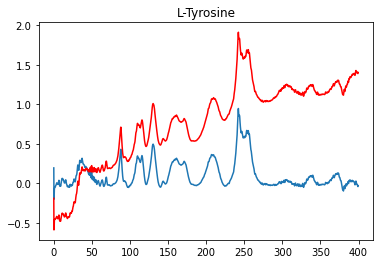

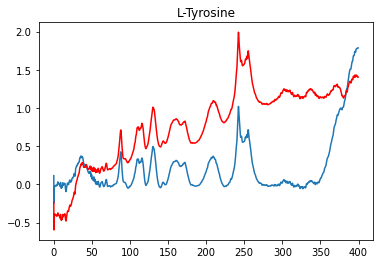

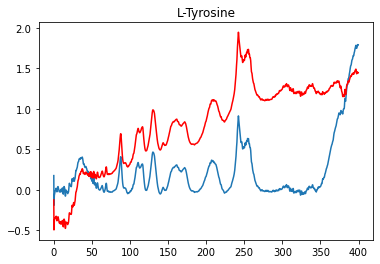

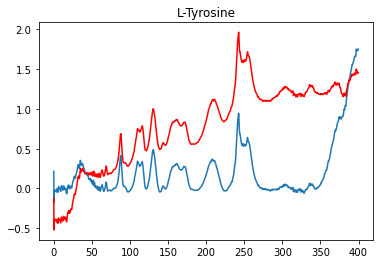

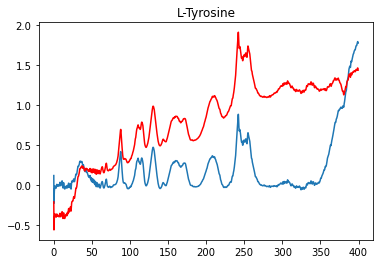

...

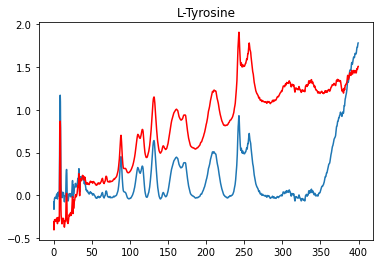

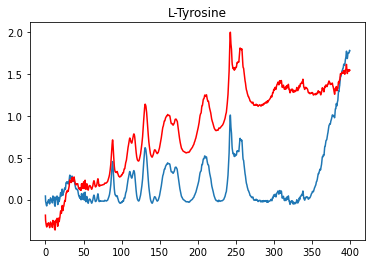

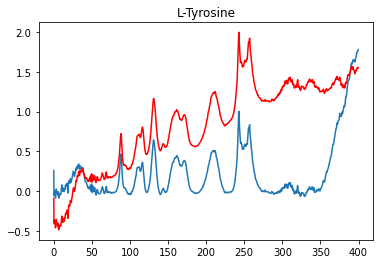

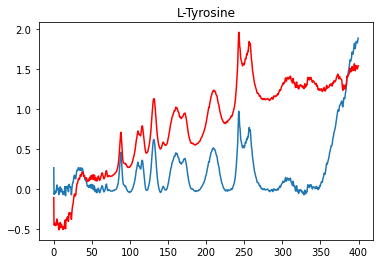

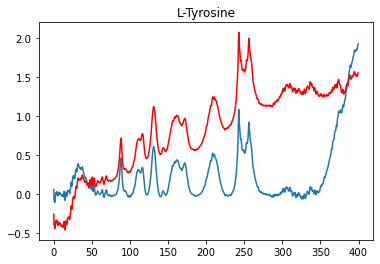

In [49]:
for i in range(len(X)):
    plt.figure()
    plt.plot(X1[i],YD1[i])
    plt.plot(X1[i],Y1[i],c = 'r')
    plt.title('L-Tyrosine')
    plt.show()

In [50]:
YD1

array([[-0.02979187, -0.03982631, -0.03659069, ..., -0.17454081,
        -0.20018878,  0.19632693],
       [ 1.78539718,  1.78091283,  1.77849474, ..., -0.12780629,
        -0.24310236,  0.11312423],
       [ 1.79288437,  1.78506897,  1.78234893, ..., -0.1481106 ,
        -0.18996392,  0.17673934],
       ...,
       [ 1.71897101,  1.71498182,  1.70908258, ..., -0.11593349,
        -0.11488929,  0.22938846],
       [ 1.90538064,  1.90024813,  1.88918182, ..., -0.09497677,
        -0.06490326,  0.29483534],
       [ 1.97329994,  1.96942143,  1.95181071, ..., -0.02220776,
         0.00860424,  0.37960623]])

In [54]:
np.save('L_Tyrosine_Baseline.npy',YD1)

### Baseline

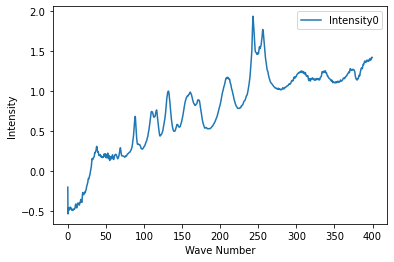

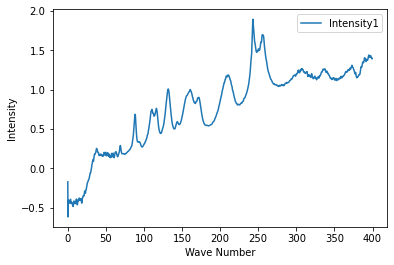

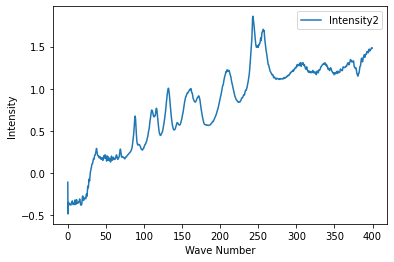

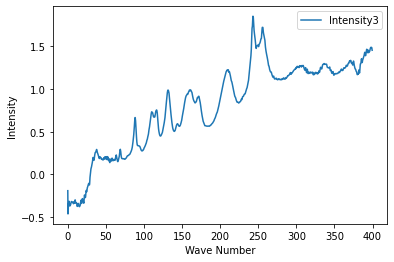

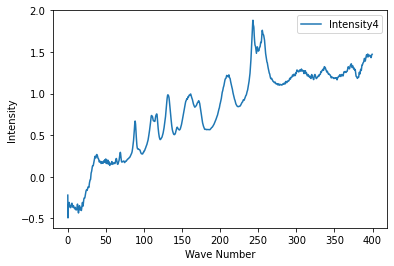

...

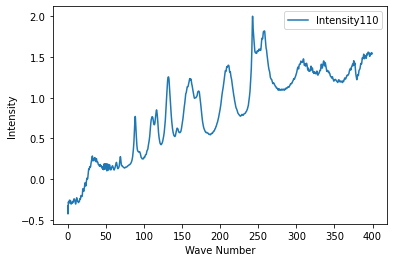

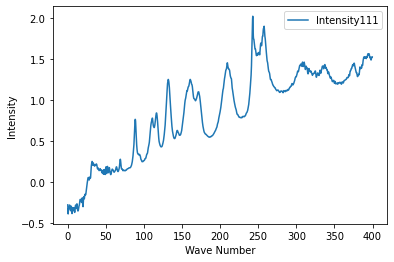

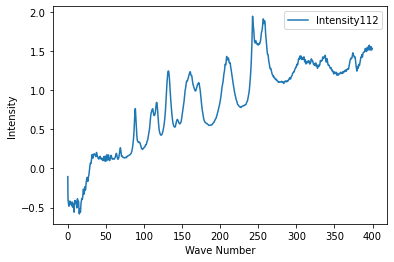

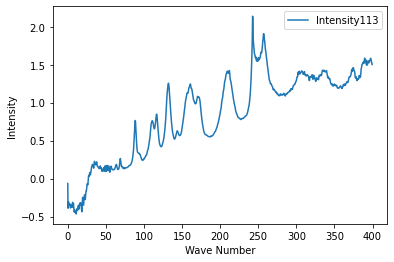

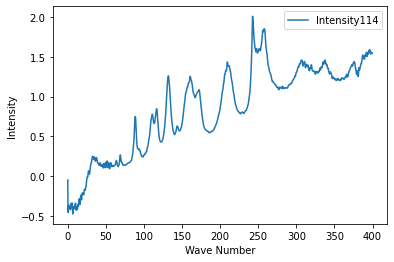

In [79]:
for i in range(0,115,1):
    df.plot(f'Wave Number{i}',f'Intensity{i}')
    plt.xlabel('Wave Number')
    plt.ylabel('Intensity')

In [7]:
y = np.array(df_all['Intenseness'])
Y = y.reshape(116,1658)
x = np.array(df_all['NumberWave'])
X = x.reshape(116,1658)

In [8]:
roi = np.array([[2,45],[50,95],[100,145],[150,195],[200,245],[250,295],[300,345],[350,395],[400,420]])
roi.shape

(9, 2)

In [9]:
ycalc_drpls, base_drpls = rampy.baseline(x,y,roi,'drPLS')

In [10]:
ycalc_drpls.shape,base_drpls.shape,x.shape

((192328, 1), (192328, 1), (192328,))

In [11]:
yd = ycalc_drpls.reshape(192328,)
yd

array([-0.01180364, -0.00535065, -0.00419763, ...,  0.09728474,
        0.11976593,  0.51356711])

In [12]:
YD = yd.reshape(116,1658)
YD.shape,type(YD)

((116, 1658), numpy.ndarray)

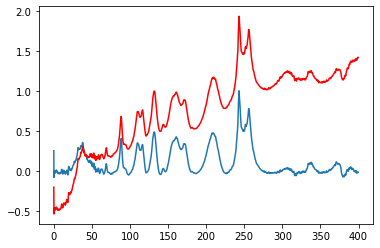

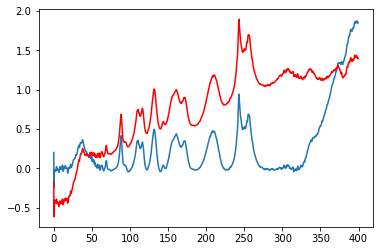

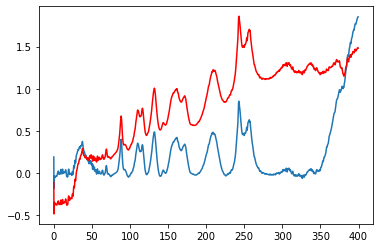

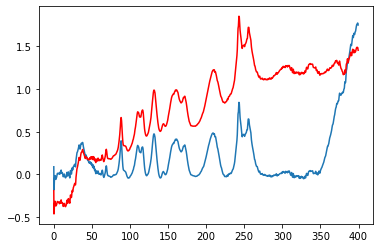

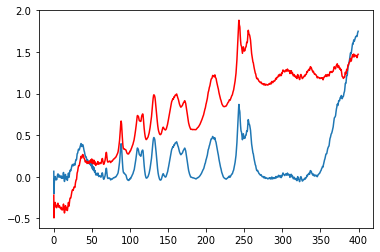

...

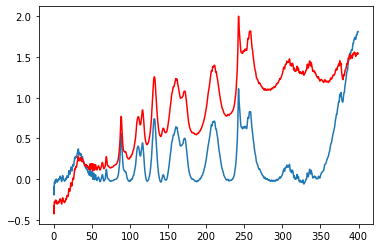

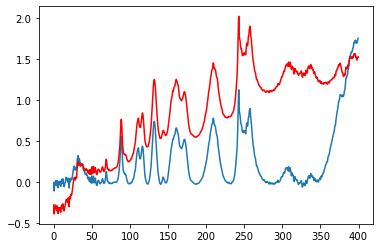

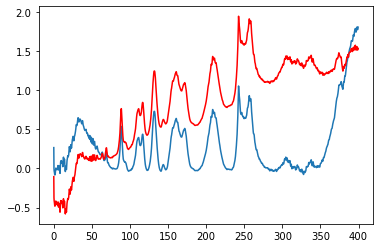

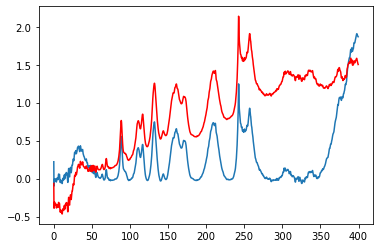

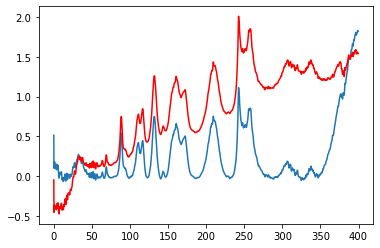

In [13]:
for i in range(len(X)):
    plt.figure()
    plt.plot(X[i],YD[i])
    plt.plot(X[i],Y[i],c = 'r')
    plt.show()

In [53]:
YD

array([[-1.18036410e-02, -5.35065208e-03, -4.19763393e-03, ...,
        -6.21412292e-02, -7.41671041e-02,  2.58549685e-01],
       [ 1.85051953e+00,  1.84275283e+00,  1.84330997e+00, ...,
        -1.41046064e-01, -2.41457670e-01,  2.00581253e-01],
       [ 1.85085160e+00,  1.84704429e+00,  1.84680020e+00, ...,
        -1.50494387e-01, -1.80683887e-01,  1.90772720e-01],
       ...,
       [ 1.80298833e+00,  1.79302717e+00,  1.77876232e+00, ...,
        -3.27040358e-02,  1.37080363e-03,  2.66093190e-01],
       [ 1.86807381e+00,  1.87065336e+00,  1.87517253e+00, ...,
        -9.64794732e-02, -9.70021194e-02,  2.21373468e-01],
       [ 1.82285808e+00,  1.82588249e+00,  1.83112749e+00, ...,
         9.72847443e-02,  1.19765931e-01,  5.13567114e-01]])

In [52]:
np.save('D_Tyrosine_Baseline.npy',YD)

## convert WaveNo to Frequency

In [55]:
df = pd.read_csv('D-Tyrosine_all_cutWaveNo.csv')

In [56]:
df=df.drop('Unnamed: 0',axis=1)
df.head()

,Wave Number0,Intensity0,Intensity1,Intensity2,Intensity3,Intensity4,Intensity5,Intensity6,Intensity7,Intensity8,Intensity9,Intensity10,Intensity11,Intensity12,Intensity13,Intensity14,Intensity15,Intensity16,Intensity17,Intensity18,Intensity19,Intensity20,Intensity21,Intensity22,Intensity23,Intensity24,Intensity25,Intensity26,Intensity27,Intensity28,Intensity29,Intensity30,Intensity31,Intensity32,Intensity33,Intensity34,Intensity35,Intensity36,Intensity37,Intensity38,Intensity39,Intensity40,Intensity41,Intensity42,Intensity43,Intensity44,Intensity45,Intensity46,Intensity47,Intensity48,Intensity49,Intensity50,Intensity51,Intensity52,Intensity53,Intensity54,Intensity55,Intensity56,Intensity57,Intensity58,Intensity59,Intensity60,Intensity61,Intensity62,Intensity63,Intensity64,Intensity65,Intensity66,Intensity67,Intensity68,Intensity69,Intensity70,Intensity71,Intensity72,Intensity73,Intensity74,Intensity75,Intensity76,Intensity77,Intensity78,Intensity79,Intensity80,Intensity81,Intensity82,Intensity83,Intensity84,Intensity85,Intensity86,Intensity87,Intensity88,Intensity89,Intensity90,Intensity91,Intensity92,Intensity93,Intensity94,Intensity95,Intensity96,Intensity97,Intensity98,Intensity99,Intensity100,Intensity101,Intensity102,Intensity103,Intensity104,Intensity105,Intensity106,Intensity107,Intensity108,Intensity109,Intensity110,Intensity111,Intensity112,Intensity113,Intensity114
0,399.45391,1.42139,1.39645,1.48092,1.45504,1.47252,1.45080,1.45564,1.46872,1.46627,1.51097,1.46379,1.62166,1.65027,1.69551,1.65769,1.53682,1.77313,1.61531,1.59106,1.61045,1.65486,1.67171,1.72327,1.64743,1.64807,1.64546,1.48919,1.48022,1.51109,1.63020,1.45307,1.45741,1.43911,1.46861,1.50932,1.47290,1.47013,1.67273,1.60830,1.39473,1.44968,1.43754,1.44423,1.44318,1.43503,1.39377,1.45352,1.42968,1.43324,1.71500,1.72168,2.09433,1.92579,1.80363,1.89451,1.80067,1.85123,1.65814,1.82210,2.13321,1.78529,1.56325,1.54664,1.55120,1.87396,1.57024,1.55526,1.58011,1.50950,1.56124,1.55047,1.53704,1.42149,1.46017,1.45372,1.44399,1.46701,1.48510,1.49873,1.47520,1.48615,1.51861,1.73539,1.92866,1.88302,1.84996,1.88153,1.85953,1.85463,1.78277,1.80640,1.80180,1.81558,1.74115,1.57220,1.53290,1.58267,1.79249,1.55252,1.55033,1.54037,1.54821,1.54280,1.53684,1.54537,1.49267,1.48910,1.51902,1.59141,1.54573,1.54116,1.52548,1.53265,1.50264,1.54115
1,399.21284,1.42504,1.38976,1.48074,1.47009,1.46987,1.46565,1.45563,1.45536,1.47556,1.50709,1.45546,1.63298,1.65484,1.70553,1.65354,1.59747,1.72438,1.66266,1.60126,1.59135,1.64934,1.66393,1.71510,1.66394,1.66721,1.63371,1.47849,1.48983,1.50444,1.66166,1.45290,1.45867,1.43833,1.47853,1.50852,1.47186,1.46983,1.63817,1.60274,1.38585,1.46004,1.44216,1.43997,1.43657,1.44756,1.38744,1.46105,1.42525,1.44520,1.69442,1.78023,2.04778,1.91641,1.82393,1.95211,1.88282,1.91972,1.65225,1.88819,2.17658,1.78893,1.56692,1.54471,1.54199,1.86862,1.56091,1.54330,1.56952,1.50991,1.55185,1.53420,1.54940,1.43603,1.46539,1.45198,1.44576,1.49103,1.48567,1.49629,1.46766,1.48433,1.51635,1.75031,1.92658,1.92554,1.88163,1.83894,1.94156,1.78603,1.74757,1.83591,1.79029,1.87712,1.73198,1.56927,1.54151,1.58734,1.75471,1.53652,1.54447,1.54635,1.54315,1.56363,1.53378,1.56654,1.50656,1.48431,1.51698,1.58347,1.53519,1.54882,1.52646,1.52581,1.51024,1.54871
2,398.97177,1.42339,1.39146,1.48422,1.48369,1.46907,1.47597,1.45231,1.44922,1.48612,1.49697,1.45463,1.64349,1.66542,1.72705,1.66895,1.66672,1.66410,1.71960,1.59909,1.60136,1.64402,1.62120,1.68848,1.65555,1.65991,1.62911,1.47392,1.47965,1.48795,1.68236,1.44958,1.46233,1.44354,1.48121,1.48966,1.47297,1.48231,1.61303,1.61790,1.37884,1.45216,1.44944,1.44023,1.43397,1.44982,1.39545,1.45774,1.42552,1.45799,1.66571,1.85871,1.99682,1.87366,1.87184,1.96439,1.90235,2.00149,1.70106,1.94340,2.13030,1.79048,1.57359,1.54947,1.53585,1.84558,1.55200,1.52612,1.55826,1.52021,1.55030,1.53529,1.55229,1.44816,1.47424,1.45443,1.44794,1.51127,1.48085,1.49207,1.46818,1.48998,1.51165,1.75299,1.91491,1.91036,1.90762,1.82459,1.92372,1.76137,1.75500,1.897

In [57]:
df1 = df[['Wave Number0']]
df_frequency=(3*10^8)/df1
df_Intensity=df.iloc[:,1:116]
df_sum = pd.concat([df_frequency,df_Intensity],axis=1)

In [58]:
df_final=df_sum.rename(columns={'Wave Number0' : 'Frequency'})

In [59]:
df_final.head()

,Frequency,Intensity0,Intensity1,Intensity2,Intensity3,Intensity4,Intensity5,Intensity6,Intensity7,Intensity8,Intensity9,Intensity10,Intensity11,Intensity12,Intensity13,Intensity14,Intensity15,Intensity16,Intensity17,Intensity18,Intensity19,Intensity20,Intensity21,Intensity22,Intensity23,Intensity24,Intensity25,Intensity26,Intensity27,Intensity28,Intensity29,Intensity30,Intensity31,Intensity32,Intensity33,Intensity34,Intensity35,Intensity36,Intensity37,Intensity38,Intensity39,Intensity40,Intensity41,Intensity42,Intensity43,Intensity44,Intensity45,Intensity46,Intensity47,Intensity48,Intensity49,Intensity50,Intensity51,Intensity52,Intensity53,Intensity54,Intensity55,Intensity56,Intensity57,Intensity58,Intensity59,Intensity60,Intensity61,Intensity62,Intensity63,Intensity64,Intensity65,Intensity66,Intensity67,Intensity68,Intensity69,Intensity70,Intensity71,Intensity72,Intensity73,Intensity74,Intensity75,Intensity76,Intensity77,Intensity78,Intensity79,Intensity80,Intensity81,Intensity82,Intensity83,Intensity84,Intensity85,Intensity86,Intensity87,Intensity88,Intensity89,Intensity90,Intensity91,Intensity92,Intensity93,Intensity94,Intensity95,Intensity96,Intensity97,Intensity98,Intensity99,Intensity100,Intensity101,Intensity102,Intensity103,Intensity104,Intensity105,Intensity106,Intensity107,Intensity108,Intensity109,Intensity110,Intensity111,Intensity112,Intensity113,Intensity114
0,0.055075,1.42139,1.39645,1.48092,1.45504,1.47252,1.45080,1.45564,1.46872,1.46627,1.51097,1.46379,1.62166,1.65027,1.69551,1.65769,1.53682,1.77313,1.61531,1.59106,1.61045,1.65486,1.67171,1.72327,1.64743,1.64807,1.64546,1.48919,1.48022,1.51109,1.63020,1.45307,1.45741,1.43911,1.46861,1.50932,1.47290,1.47013,1.67273,1.60830,1.39473,1.44968,1.43754,1.44423,1.44318,1.43503,1.39377,1.45352,1.42968,1.43324,1.71500,1.72168,2.09433,1.92579,1.80363,1.89451,1.80067,1.85123,1.65814,1.82210,2.13321,1.78529,1.56325,1.54664,1.55120,1.87396,1.57024,1.55526,1.58011,1.50950,1.56124,1.55047,1.53704,1.42149,1.46017,1.45372,1.44399,1.46701,1.48510,1.49873,1.47520,1.48615,1.51861,1.73539,1.92866,1.88302,1.84996,1.88153,1.85953,1.85463,1.78277,1.80640,1.80180,1.81558,1.74115,1.57220,1.53290,1.58267,1.79249,1.55252,1.55033,1.54037,1.54821,1.54280,1.53684,1.54537,1.49267,1.48910,1.51902,1.59141,1.54573,1.54116,1.52548,1.53265,1.50264,1.54115
1,0.055108,1.42504,1.38976,1.48074,1.47009,1.46987,1.46565,1.45563,1.45536,1.47556,1.50709,1.45546,1.63298,1.65484,1.70553,1.65354,1.59747,1.72438,1.66266,1.60126,1.59135,1.64934,1.66393,1.71510,1.66394,1.66721,1.63371,1.47849,1.48983,1.50444,1.66166,1.45290,1.45867,1.43833,1.47853,1.50852,1.47186,1.46983,1.63817,1.60274,1.38585,1.46004,1.44216,1.43997,1.43657,1.44756,1.38744,1.46105,1.42525,1.44520,1.69442,1.78023,2.04778,1.91641,1.82393,1.95211,1.88282,1.91972,1.65225,1.88819,2.17658,1.78893,1.56692,1.54471,1.54199,1.86862,1.56091,1.54330,1.56952,1.50991,1.55185,1.53420,1.54940,1.43603,1.46539,1.45198,1.44576,1.49103,1.48567,1.49629,1.46766,1.48433,1.51635,1.75031,1.92658,1.92554,1.88163,1.83894,1.94156,1.78603,1.74757,1.83591,1.79029,1.87712,1.73198,1.56927,1.54151,1.58734,1.75471,1.53652,1.54447,1.54635,1.54315,1.56363,1.53378,1.56654,1.50656,1.48431,1.51698,1.58347,1.53519,1.54882,1.52646,1.52581,1.51024,1.54871
2,0.055142,1.42339,1.39146,1.48422,1.48369,1.46907,1.47597,1.45231,1.44922,1.48612,1.49697,1.45463,1.64349,1.66542,1.72705,1.66895,1.66672,1.66410,1.71960,1.59909,1.60136,1.64402,1.62120,1.68848,1.65555,1.65991,1.62911,1.47392,1.47965,1.48795,1.68236,1.44958,1.46233,1.44354,1.48121,1.48966,1.47297,1.48231,1.61303,1.61790,1.37884,1.45216,1.44944,1.44023,1.43397,1.44982,1.39545,1.45774,1.42552,1.45799,1.66571,1.85871,1.99682,1.87366,1.87184,1.96439,1.90235,2.00149,1.70106,1.94340,2.13030,1.79048,1.57359,1.54947,1.53585,1.84558,1.55200,1.52612,1.55826,1.52021,1.55030,1.53529,1.55229,1.44816,1.47424,1.45443,1.44794,1.51127,1.48085,1.49207,1.46818,1.48998,1.51165,1.75299,1.91491,1.91036,1.90762,1.82459,1.92372,1.76137,1.75500,1.89706,1.7

In [60]:
df_F = df_final.iloc[1353:1628,:]
df_F

,Frequency,Intensity0,Intensity1,Intensity2,Intensity3,Intensity4,Intensity5,Intensity6,Intensity7,Intensity8,Intensity9,Intensity10,Intensity11,Intensity12,Intensity13,Intensity14,Intensity15,Intensity16,Intensity17,Intensity18,Intensity19,Intensity20,Intensity21,Intensity22,Intensity23,Intensity24,Intensity25,Intensity26,Intensity27,Intensity28,Intensity29,Intensity30,Intensity31,Intensity32,Intensity33,Intensity34,Intensity35,Intensity36,Intensity37,Intensity38,Intensity39,Intensity40,Intensity41,Intensity42,Intensity43,Intensity44,Intensity45,Intensity46,Intensity47,Intensity48,Intensity49,Intensity50,Intensity51,Intensity52,Intensity53,Intensity54,Intensity55,Intensity56,Intensity57,Intensity58,Intensity59,Intensity60,Intensity61,Intensity62,Intensity63,Intensity64,Intensity65,Intensity66,Intensity67,Intensity68,Intensity69,Intensity70,Intensity71,Intensity72,Intensity73,Intensity74,Intensity75,Intensity76,Intensity77,Intensity78,Intensity79,Intensity80,Intensity81,Intensity82,Intensity83,Intensity84,Intensity85,Intensity86,Intensity87,Intensity88,Intensity89,Intensity90,Intensity91,Intensity92,Intensity93,Intensity94,Intensity95,Intensity96,Intensity97,Intensity98,Intensity99,Intensity100,Intensity101,Intensity102,Intensity103,Intensity104,Intensity105,Intensity106,Intensity107,Intensity108,Intensity109,Intensity110,Intensity111,Intensity112,Intensity113,Intensity114
1353,0.300196,0.19005,0.18486,0.18657,0.18505,0.18858,0.18406,0.18809,0.18496,0.18398,0.18601,0.18140,0.09461,0.25409,0.10110,0.08023,0.09090,0.10043,0.11090,0.09135,0.09709,0.09709,0.09735,0.13608,0.10478,0.09728,0.09625,0.17168,0.16139,0.16777,0.10269,0.17181,0.16475,0.16377,0.16199,0.16649,0.15464,0.16197,0.10972,0.10604,0.16010,0.15163,0.16678,0.15253,0.15702,0.15583,0.15365,0.15992,0.14900,0.16662,0.15053,0.08635,0.06920,0.07544,0.08611,0.10191,0.08746,0.08930,0.08137,0.08470,0.09290,0.08816,0.16328,0.15131,0.15877,0.09754,0.16232,0.15908,0.14331,0.16169,0.16359,0.15171,0.15819,0.13797,0.14467,0.15624,0.15153,0.14886,0.14629,0.15015,0.15129,0.15040,0.15723,0.18869,0.08330,0.07808,0.07665,0.08471,0.09244,0.08145,0.07860,0.07625,0.07905,0.08266,0.07950,0.14608,0.12419,0.15303,0.08439,0.15386,0.14213,0.13683,0.14322,0.13635,0.14318,0.15249,0.14328,0.13438,0.14538,0.13810,0.14617,0.14522,0.14339,0.13994,0.14442,0.14234
1354,0.301187,0.19094,0.18610,0.18796,0.18392,0.18586,0.18391,0.18709,0.18605,0.18394,0.18284,0.17878,0.09430,0.25434,0.10126,0.07707,0.09165,0.10035,0.11201,0.09165,0.09462,0.09791,0.09645,0.13031,0.10561,0.09549,0.09705,0.16767,0.15915,0.16545,0.10298,0.16864,0.16543,0.16293,0.16571,0.16578,0.15156,0.16693,0.10945,0.10424,0.16083,0.15597,0.16877,0.15164,0.15660,0.15223,0.15499,0.16037,0.14774,0.16466,0.15740,0.08920,0.07006,0.07430,0.08423,0.09978,0.08497,0.08927,0.07993,0.08432,0.09208,0.08631,0.16400,0.15442,0.15716,0.09879,0.16221,0.16238,0.14528,0.16054,0.16508,0.14845,0.15671,0.13610,0.14701,0.15864,0.15103,0.14962,0.14577,0.14662,0.14400,0.14870,0.15192,0.18574,0.08411,0.07754,0.07448,0.08329,0.09141,0.08059,0.08068,0.07601,0.07942,0.08438,0.07929,0.14783,0.12531,0.15447,0.08627,0.15356,0.14171,0.13700,0.14404,0.13876,0.14387,0.15186,0.14209,0.13417,0.14699,0.13885,0.14514,0.14836,0.14068,0.13944,0.13863,0.14400
1355,0.302184,0.19159,0.18644,0.18853,0.18279,0.18354,0.18337,0.18663,0.18607,0.18399,0.17809,0.17677,0.09370,0.26004,0.09979,0.07749,0.09541,0.10196,0.11367,0.09290,0.09266,0.09866,0.09581,0.12343,0.10513,0.09329,0.09533,0.16430,0.15750,0.16456,0.10358,0.16285,0.16667,0.16259,0.16718,0.16504,0.15638,0.17294,0.10890,0.10366,0.16190,0.15841,0.16726,0.15031,0.15637,0.14991,0.16006,0.16181,0.14743,0.16055,0.18044,0.08976,0.07404,0.07717,0.08661,0.09662,0.08222,0.08816,0.07930,0.08550,0.09148,0.08405,0.16268,0.15541,0.15513,0.10056,0.16239,0.16421,0.15035,0.15695,0.16209,0.15119,0.15520,0.13653,0.14803,0.15890,0.15146,0.15059,0.14589,0.14179,0.13891,0.14687,0.14566,0.18924,0.08439,0.07726,0.07582,0.08380,0.09109,0.08043,0.08221,0.

In [70]:
df_F.to_csv('CropSpec_D-Tyrosine.csv')

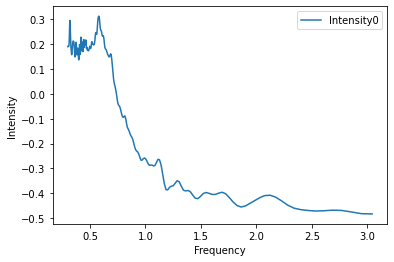

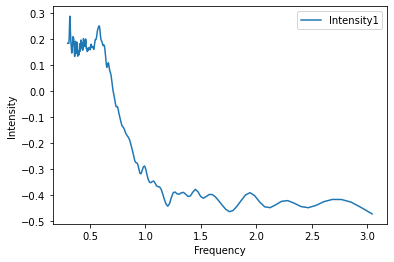

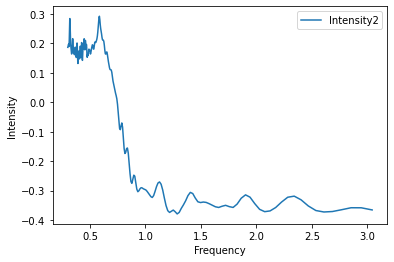

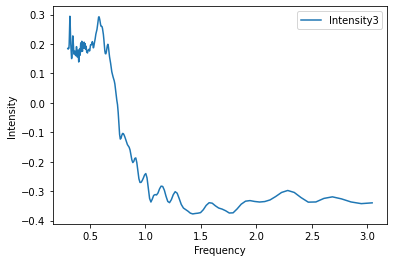

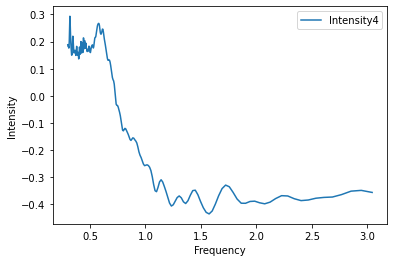

...

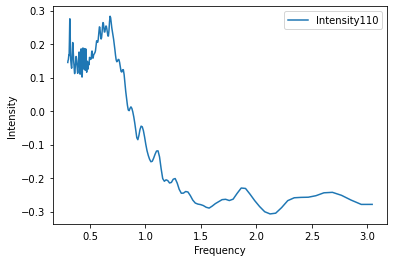

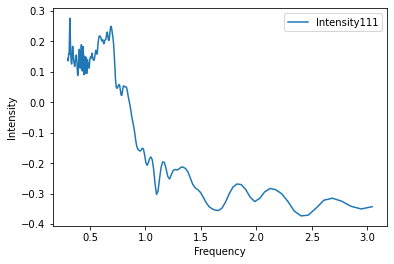

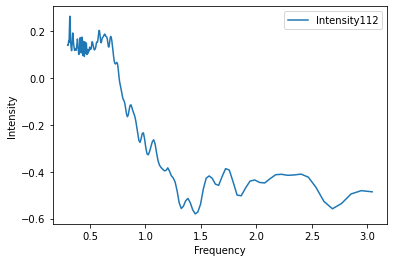

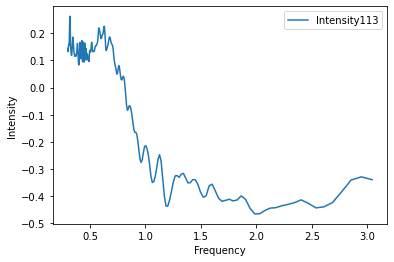

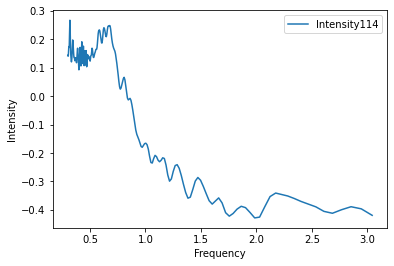

In [40]:
for i in range(0,115,1):
    df_F.plot('Frequency',f'Intensity{i}')
    plt.xlabel('Frequency')
    plt.ylabel('Intensity')

In [62]:
dfL = pd.read_csv('L-(-)-Tyrosine_allCutWaveNo.csv')
dfL.head()

,Unnamed: 0,Wave Number0,Intensity0,Intensity1,Intensity2,Intensity3,Intensity4,Intensity5,Intensity6,Intensity7,Intensity8,Intensity9,Intensity10,Intensity11,Intensity12,Intensity13,Intensity14,Intensity15,Intensity16,Intensity17,Intensity18,Intensity19,Intensity20,Intensity21,Intensity22,Intensity23,Intensity24,Intensity25,Intensity26,Intensity27,Intensity28,Intensity29,Intensity30,Intensity31,Intensity32,Intensity33,Intensity34,Intensity35,Intensity36,Intensity37,Intensity38,Intensity39,Intensity40,Intensity41,Intensity42,Intensity43,Intensity44,Intensity45,Intensity46,Intensity47,Intensity48,Intensity49,Intensity50,Intensity51,Intensity52,Intensity53,Intensity54,Intensity55,Intensity56,Intensity57,Intensity58,Intensity59,Intensity60,Intensity61,Intensity62,Intensity63,Intensity64,Intensity65,Intensity66,Intensity67,Intensity68,Intensity69,Intensity70,Intensity71,Intensity72,Intensity73,Intensity74,Intensity75,Intensity76,Intensity77,Intensity78,Intensity79,Intensity80,Intensity81,Intensity82,Intensity83,Intensity84,Intensity85,Intensity86,Intensity87,Intensity88,Intensity89,Intensity90,Intensity91,Intensity92,Intensity93,Intensity94,Intensity95,Intensity96,Intensity97,Intensity98,Intensity99,Intensity100,Intensity101,Intensity102,Intensity103,Intensity104,Intensity105,Intensity106,Intensity107,Intensity108,Intensity109,Intensity110,Intensity111,Intensity112,Intensity113,Intensity114,Intensity115,Intensity116,Intensity117,Intensity118,Intensity119
0,0,399.45391,1.40377,1.40352,1.44629,1.45580,1.43729,1.46473,1.47673,1.44697,1.45008,1.46958,1.46022,2.03396,1.95873,1.90770,1.57354,1.78591,1.86473,1.79362,1.75245,1.58939,1.86598,1.70328,1.76260,1.77365,1.89076,2.34978,1.89949,1.66316,1.59886,1.83075,1.68129,1.65250,1.62558,1.58575,1.60993,1.63743,1.63715,1.65674,1.60407,1.62451,1.62071,1.67192,1.68183,1.65103,1.50569,1.54951,1.57630,1.58372,1.52005,1.57788,1.57263,1.56263,1.56181,1.54272,1.81883,2.05887,1.97193,2.01568,1.84144,1.91402,1.81382,1.88563,1.75800,2.06640,1.92131,1.79103,1.50825,1.57165,1.54701,1.86349,1.53163,1.55484,1.58112,1.53254,1.55972,1.56168,1.55620,1.42240,1.46503,1.50186,1.46684,1.53738,1.47173,1.50358,1.47438,1.49071,1.45480,1.91289,1.94813,1.92739,1.83509,1.84411,1.96443,1.78283,1.83153,2.00525,1.92314,2.08091,2.03868,1.59441,1.60415,1.58428,1.94206,1.63004,1.56791,1.60493,1.60638,1.59565,1.60392,1.64133,1.50427,1.54095,1.55354,1.54258,1.55438,1.55253,1.54554,1.54234,1.57082,1.60106
1,1,399.21284,1.39091,1.40243,1.44225,1.44953,1.45177,1.46293,1.47336,1.45205,1.45848,1.46751,1.46058,2.09832,1.98091,1.95888,1.57940,1.74640,1.82130,1.75899,1.72880,1.62699,1.85037,1.67037,1.79248,1.74848,1.90154,2.42972,1.86929,1.67311,1.58479,1.85292,1.69911,1.64116,1.60802,1.59524,1.59140,1.61939,1.62341,1.63714,1.59261,1.62667,1.63272,1.65636,1.71923,1.62654,1.51722,1.56098,1.58135,1.58275,1.53771,1.57455,1.57496,1.55651,1.56104,1.53095,1.81730,2.02586,1.94022,2.01165,1.89171,1.86395,1.81251,1.89744,1.77722,2.05989,1.99718,1.79333,1.51339,1.56679,1.55639,1.88774,1.54296,1.56335,1.58440,1.53858,1.57075,1.58208,1.56529,1.42483,1.46520,1.49634,1.47586,1.54075,1.46961,1.50663,1.48556,1.48631,1.44955,1.89118,1.93316,1.96618,1.83394,1.81848,1.98302,1.80234,1.81063,2.11345,1.94698,2.11438,2.11059,1.59860,1.60889,1.57825,1.92401,1.62836,1.55654,1.62092,1.59865,1.60315,1.61856,1.65749,1.50384,1.54987,1.54325,1.53191,1.55162,1.56229,1.54393,1.54231,1.56969,1.60178
2,2,398.97177,1.39132,1.40350,1.44340,1.44495,1.46335,1.46337,1.46395,1.45021,1.46689,1.46509,1.46249,2.16262,1.99515,2.02407,1.58835,1.73831,1.78295,1.70956,1.71153,1.65275,1.83324,1.65798,1.85035,1.72894,1.85590,2.41780,1.87633,1.68609,1.58046,1.87328,1.69016,1.60630,1.58715,1.60784,1.58003,1.61589,1.62479,1.60496,1.56847,1.62887,1.64574,1.64174,1.75701,1.60551,1.51257,1.56744,1.56974,1.57901,1.56267,1.56371,1.56424,1.55549,1.56644,1.53606,1.81605,1.97274,1.85206,1.98258,1.96844,1.83962,1.77040,1.90320,1.80439,2.00235,2.02075,1.80765,1.51238,1.55752,1.55599,1.91837,1.5

In [63]:
dfL=dfL.drop('Unnamed: 0',axis=1)
dfL

,Wave Number0,Intensity0,Intensity1,Intensity2,Intensity3,Intensity4,Intensity5,Intensity6,Intensity7,Intensity8,Intensity9,Intensity10,Intensity11,Intensity12,Intensity13,Intensity14,Intensity15,Intensity16,Intensity17,Intensity18,Intensity19,Intensity20,Intensity21,Intensity22,Intensity23,Intensity24,Intensity25,Intensity26,Intensity27,Intensity28,Intensity29,Intensity30,Intensity31,Intensity32,Intensity33,Intensity34,Intensity35,Intensity36,Intensity37,Intensity38,Intensity39,Intensity40,Intensity41,Intensity42,Intensity43,Intensity44,Intensity45,Intensity46,Intensity47,Intensity48,Intensity49,Intensity50,Intensity51,Intensity52,Intensity53,Intensity54,Intensity55,Intensity56,Intensity57,Intensity58,Intensity59,Intensity60,Intensity61,Intensity62,Intensity63,Intensity64,Intensity65,Intensity66,Intensity67,Intensity68,Intensity69,Intensity70,Intensity71,Intensity72,Intensity73,Intensity74,Intensity75,Intensity76,Intensity77,Intensity78,Intensity79,Intensity80,Intensity81,Intensity82,Intensity83,Intensity84,Intensity85,Intensity86,Intensity87,Intensity88,Intensity89,Intensity90,Intensity91,Intensity92,Intensity93,Intensity94,Intensity95,Intensity96,Intensity97,Intensity98,Intensity99,Intensity100,Intensity101,Intensity102,Intensity103,Intensity104,Intensity105,Intensity106,Intensity107,Intensity108,Intensity109,Intensity110,Intensity111,Intensity112,Intensity113,Intensity114,Intensity115,Intensity116,Intensity117,Intensity118,Intensity119
0,399.45391,1.40377,1.40352,1.44629,1.45580,1.43729,1.46473,1.47673,1.44697,1.45008,1.46958,1.46022,2.03396,1.95873,1.90770,1.57354,1.78591,1.86473,1.79362,1.75245,1.58939,1.86598,1.70328,1.76260,1.77365,1.89076,2.34978,1.89949,1.66316,1.59886,1.83075,1.68129,1.65250,1.62558,1.58575,1.60993,1.63743,1.63715,1.65674,1.60407,1.62451,1.62071,1.67192,1.68183,1.65103,1.50569,1.54951,1.57630,1.58372,1.52005,1.57788,1.57263,1.56263,1.56181,1.54272,1.81883,2.05887,1.97193,2.01568,1.84144,1.91402,1.81382,1.88563,1.75800,2.06640,1.92131,1.79103,1.50825,1.57165,1.54701,1.86349,1.53163,1.55484,1.58112,1.53254,1.55972,1.56168,1.55620,1.42240,1.46503,1.50186,1.46684,1.53738,1.47173,1.50358,1.47438,1.49071,1.45480,1.91289,1.94813,1.92739,1.83509,1.84411,1.96443,1.78283,1.83153,2.00525,1.92314,2.08091,2.03868,1.59441,1.60415,1.58428,1.94206,1.63004,1.56791,1.60493,1.60638,1.59565,1.60392,1.64133,1.50427,1.54095,1.55354,1.54258,1.55438,1.55253,1.54554,1.54234,1.57082,1.60106
1,399.21284,1.39091,1.40243,1.44225,1.44953,1.45177,1.46293,1.47336,1.45205,1.45848,1.46751,1.46058,2.09832,1.98091,1.95888,1.57940,1.74640,1.82130,1.75899,1.72880,1.62699,1.85037,1.67037,1.79248,1.74848,1.90154,2.42972,1.86929,1.67311,1.58479,1.85292,1.69911,1.64116,1.60802,1.59524,1.59140,1.61939,1.62341,1.63714,1.59261,1.62667,1.63272,1.65636,1.71923,1.62654,1.51722,1.56098,1.58135,1.58275,1.53771,1.57455,1.57496,1.55651,1.56104,1.53095,1.81730,2.02586,1.94022,2.01165,1.89171,1.86395,1.81251,1.89744,1.77722,2.05989,1.99718,1.79333,1.51339,1.56679,1.55639,1.88774,1.54296,1.56335,1.58440,1.53858,1.57075,1.58208,1.56529,1.42483,1.46520,1.49634,1.47586,1.54075,1.46961,1.50663,1.48556,1.48631,1.44955,1.89118,1.93316,1.96618,1.83394,1.81848,1.98302,1.80234,1.81063,2.11345,1.94698,2.11438,2.11059,1.59860,1.60889,1.57825,1.92401,1.62836,1.55654,1.62092,1.59865,1.60315,1.61856,1.65749,1.50384,1.54987,1.54325,1.53191,1.55162,1.56229,1.54393,1.54231,1.56969,1.60178
2,398.97177,1.39132,1.40350,1.44340,1.44495,1.46335,1.46337,1.46395,1.45021,1.46689,1.46509,1.46249,2.16262,1.99515,2.02407,1.58835,1.73831,1.78295,1.70956,1.71153,1.65275,1.83324,1.65798,1.85035,1.72894,1.85590,2.41780,1.87633,1.68609,1.58046,1.87328,1.69016,1.60630,1.58715,1.60784,1.58003,1.61589,1.62479,1.60496,1.56847,1.62887,1.64574,1.64174,1.75701,1.60551,1.51257,1.56744,1.56974,1.57901,1.56267,1.56371,1.56424,1.55549,1.56644,1.53606,1.81605,1.97274,1.85206,1.98258,1.96844,1.83962,1.77040,1.90320,1.80439,2.00235,2.02075,1.80765,1.51238,1.55752,1.55599,1.91837,1.54934,1.57272,1.57

In [62]:
dfL.iloc[:,1:121]

,Intensity0,Intensity1,Intensity2,Intensity3,Intensity4,Intensity5,Intensity6,Intensity7,Intensity8,Intensity9,Intensity10,Intensity11,Intensity12,Intensity13,Intensity14,Intensity15,Intensity16,Intensity17,Intensity18,Intensity19,Intensity20,Intensity21,Intensity22,Intensity23,Intensity24,Intensity25,Intensity26,Intensity27,Intensity28,Intensity29,Intensity30,Intensity31,Intensity32,Intensity33,Intensity34,Intensity35,Intensity36,Intensity37,Intensity38,Intensity39,Intensity40,Intensity41,Intensity42,Intensity43,Intensity44,Intensity45,Intensity46,Intensity47,Intensity48,Intensity49,Intensity50,Intensity51,Intensity52,Intensity53,Intensity54,Intensity55,Intensity56,Intensity57,Intensity58,Intensity59,Intensity60,Intensity61,Intensity62,Intensity63,Intensity64,Intensity65,Intensity66,Intensity67,Intensity68,Intensity69,Intensity70,Intensity71,Intensity72,Intensity73,Intensity74,Intensity75,Intensity76,Intensity77,Intensity78,Intensity79,Intensity80,Intensity81,Intensity82,Intensity83,Intensity84,Intensity85,Intensity86,Intensity87,Intensity88,Intensity89,Intensity90,Intensity91,Intensity92,Intensity93,Intensity94,Intensity95,Intensity96,Intensity97,Intensity98,Intensity99,Intensity100,Intensity101,Intensity102,Intensity103,Intensity104,Intensity105,Intensity106,Intensity107,Intensity108,Intensity109,Intensity110,Intensity111,Intensity112,Intensity113,Intensity114,Intensity115,Intensity116,Intensity117,Intensity118,Intensity119
0,1.40377,1.40352,1.44629,1.45580,1.43729,1.46473,1.47673,1.44697,1.45008,1.46958,1.46022,2.03396,1.95873,1.90770,1.57354,1.78591,1.86473,1.79362,1.75245,1.58939,1.86598,1.70328,1.76260,1.77365,1.89076,2.34978,1.89949,1.66316,1.59886,1.83075,1.68129,1.65250,1.62558,1.58575,1.60993,1.63743,1.63715,1.65674,1.60407,1.62451,1.62071,1.67192,1.68183,1.65103,1.50569,1.54951,1.57630,1.58372,1.52005,1.57788,1.57263,1.56263,1.56181,1.54272,1.81883,2.05887,1.97193,2.01568,1.84144,1.91402,1.81382,1.88563,1.75800,2.06640,1.92131,1.79103,1.50825,1.57165,1.54701,1.86349,1.53163,1.55484,1.58112,1.53254,1.55972,1.56168,1.55620,1.42240,1.46503,1.50186,1.46684,1.53738,1.47173,1.50358,1.47438,1.49071,1.45480,1.91289,1.94813,1.92739,1.83509,1.84411,1.96443,1.78283,1.83153,2.00525,1.92314,2.08091,2.03868,1.59441,1.60415,1.58428,1.94206,1.63004,1.56791,1.60493,1.60638,1.59565,1.60392,1.64133,1.50427,1.54095,1.55354,1.54258,1.55438,1.55253,1.54554,1.54234,1.57082,1.60106
1,1.39091,1.40243,1.44225,1.44953,1.45177,1.46293,1.47336,1.45205,1.45848,1.46751,1.46058,2.09832,1.98091,1.95888,1.57940,1.74640,1.82130,1.75899,1.72880,1.62699,1.85037,1.67037,1.79248,1.74848,1.90154,2.42972,1.86929,1.67311,1.58479,1.85292,1.69911,1.64116,1.60802,1.59524,1.59140,1.61939,1.62341,1.63714,1.59261,1.62667,1.63272,1.65636,1.71923,1.62654,1.51722,1.56098,1.58135,1.58275,1.53771,1.57455,1.57496,1.55651,1.56104,1.53095,1.81730,2.02586,1.94022,2.01165,1.89171,1.86395,1.81251,1.89744,1.77722,2.05989,1.99718,1.79333,1.51339,1.56679,1.55639,1.88774,1.54296,1.56335,1.58440,1.53858,1.57075,1.58208,1.56529,1.42483,1.46520,1.49634,1.47586,1.54075,1.46961,1.50663,1.48556,1.48631,1.44955,1.89118,1.93316,1.96618,1.83394,1.81848,1.98302,1.80234,1.81063,2.11345,1.94698,2.11438,2.11059,1.59860,1.60889,1.57825,1.92401,1.62836,1.55654,1.62092,1.59865,1.60315,1.61856,1.65749,1.50384,1.54987,1.54325,1.53191,1.55162,1.56229,1.54393,1.54231,1.56969,1.60178
2,1.39132,1.40350,1.44340,1.44495,1.46335,1.46337,1.46395,1.45021,1.46689,1.46509,1.46249,2.16262,1.99515,2.02407,1.58835,1.73831,1.78295,1.70956,1.71153,1.65275,1.83324,1.65798,1.85035,1.72894,1.85590,2.41780,1.87633,1.68609,1.58046,1.87328,1.69016,1.60630,1.58715,1.60784,1.58003,1.61589,1.62479,1.60496,1.56847,1.62887,1.64574,1.64174,1.75701,1.60551,1.51257,1.56744,1.56974,1.57901,1.56267,1.56371,1.56424,1.55549,1.56644,1.53606,1.81605,1.97274,1.85206,1.98258,1.96844,1.83962,1.77040,1.90320,1.80439,2.00235,2.02075,1.80765,1.51238,1.55752,1.55599,1.91837,1.54934,1.57272,1.57514,1.54491,1.57828,1.60241,1.56809,1.42575

In [64]:
dfT = dfL[['Wave Number0']]
df_frequencyL=(3*10^8)/dfT
df_IntensityL=dfL.iloc[:,1:121]
df_sumL = pd.concat([df_frequencyL,df_IntensityL],axis=1)

In [65]:
df_finalL=df_sumL.rename(columns={'Wave Number0' : 'Frequency'})

In [66]:
df_finalL.head()

,Frequency,Intensity0,Intensity1,Intensity2,Intensity3,Intensity4,Intensity5,Intensity6,Intensity7,Intensity8,Intensity9,Intensity10,Intensity11,Intensity12,Intensity13,Intensity14,Intensity15,Intensity16,Intensity17,Intensity18,Intensity19,Intensity20,Intensity21,Intensity22,Intensity23,Intensity24,Intensity25,Intensity26,Intensity27,Intensity28,Intensity29,Intensity30,Intensity31,Intensity32,Intensity33,Intensity34,Intensity35,Intensity36,Intensity37,Intensity38,Intensity39,Intensity40,Intensity41,Intensity42,Intensity43,Intensity44,Intensity45,Intensity46,Intensity47,Intensity48,Intensity49,Intensity50,Intensity51,Intensity52,Intensity53,Intensity54,Intensity55,Intensity56,Intensity57,Intensity58,Intensity59,Intensity60,Intensity61,Intensity62,Intensity63,Intensity64,Intensity65,Intensity66,Intensity67,Intensity68,Intensity69,Intensity70,Intensity71,Intensity72,Intensity73,Intensity74,Intensity75,Intensity76,Intensity77,Intensity78,Intensity79,Intensity80,Intensity81,Intensity82,Intensity83,Intensity84,Intensity85,Intensity86,Intensity87,Intensity88,Intensity89,Intensity90,Intensity91,Intensity92,Intensity93,Intensity94,Intensity95,Intensity96,Intensity97,Intensity98,Intensity99,Intensity100,Intensity101,Intensity102,Intensity103,Intensity104,Intensity105,Intensity106,Intensity107,Intensity108,Intensity109,Intensity110,Intensity111,Intensity112,Intensity113,Intensity114,Intensity115,Intensity116,Intensity117,Intensity118,Intensity119
0,0.055075,1.40377,1.40352,1.44629,1.45580,1.43729,1.46473,1.47673,1.44697,1.45008,1.46958,1.46022,2.03396,1.95873,1.90770,1.57354,1.78591,1.86473,1.79362,1.75245,1.58939,1.86598,1.70328,1.76260,1.77365,1.89076,2.34978,1.89949,1.66316,1.59886,1.83075,1.68129,1.65250,1.62558,1.58575,1.60993,1.63743,1.63715,1.65674,1.60407,1.62451,1.62071,1.67192,1.68183,1.65103,1.50569,1.54951,1.57630,1.58372,1.52005,1.57788,1.57263,1.56263,1.56181,1.54272,1.81883,2.05887,1.97193,2.01568,1.84144,1.91402,1.81382,1.88563,1.75800,2.06640,1.92131,1.79103,1.50825,1.57165,1.54701,1.86349,1.53163,1.55484,1.58112,1.53254,1.55972,1.56168,1.55620,1.42240,1.46503,1.50186,1.46684,1.53738,1.47173,1.50358,1.47438,1.49071,1.45480,1.91289,1.94813,1.92739,1.83509,1.84411,1.96443,1.78283,1.83153,2.00525,1.92314,2.08091,2.03868,1.59441,1.60415,1.58428,1.94206,1.63004,1.56791,1.60493,1.60638,1.59565,1.60392,1.64133,1.50427,1.54095,1.55354,1.54258,1.55438,1.55253,1.54554,1.54234,1.57082,1.60106
1,0.055108,1.39091,1.40243,1.44225,1.44953,1.45177,1.46293,1.47336,1.45205,1.45848,1.46751,1.46058,2.09832,1.98091,1.95888,1.57940,1.74640,1.82130,1.75899,1.72880,1.62699,1.85037,1.67037,1.79248,1.74848,1.90154,2.42972,1.86929,1.67311,1.58479,1.85292,1.69911,1.64116,1.60802,1.59524,1.59140,1.61939,1.62341,1.63714,1.59261,1.62667,1.63272,1.65636,1.71923,1.62654,1.51722,1.56098,1.58135,1.58275,1.53771,1.57455,1.57496,1.55651,1.56104,1.53095,1.81730,2.02586,1.94022,2.01165,1.89171,1.86395,1.81251,1.89744,1.77722,2.05989,1.99718,1.79333,1.51339,1.56679,1.55639,1.88774,1.54296,1.56335,1.58440,1.53858,1.57075,1.58208,1.56529,1.42483,1.46520,1.49634,1.47586,1.54075,1.46961,1.50663,1.48556,1.48631,1.44955,1.89118,1.93316,1.96618,1.83394,1.81848,1.98302,1.80234,1.81063,2.11345,1.94698,2.11438,2.11059,1.59860,1.60889,1.57825,1.92401,1.62836,1.55654,1.62092,1.59865,1.60315,1.61856,1.65749,1.50384,1.54987,1.54325,1.53191,1.55162,1.56229,1.54393,1.54231,1.56969,1.60178
2,0.055142,1.39132,1.40350,1.44340,1.44495,1.46335,1.46337,1.46395,1.45021,1.46689,1.46509,1.46249,2.16262,1.99515,2.02407,1.58835,1.73831,1.78295,1.70956,1.71153,1.65275,1.83324,1.65798,1.85035,1.72894,1.85590,2.41780,1.87633,1.68609,1.58046,1.87328,1.69016,1.60630,1.58715,1.60784,1.58003,1.61589,1.62479,1.60496,1.56847,1.62887,1.64574,1.64174,1.75701,1.60551,1.51257,1.56744,1.56974,1.57901,1.56267,1.56371,1.56424,1.55549,1.56644,1.53606,1.81605,1.97274,1.85206,1.98258,1.96844,1.83962,1.77040,1.90320,1.80439,2.00235,2.02075,1.80765,1.51238,1.55752,1.55599,1.91837,1.54934,1.57272,1.57514,1.

In [67]:
df_L = df_finalL.iloc[1353:1628,:]
df_L

,Frequency,Intensity0,Intensity1,Intensity2,Intensity3,Intensity4,Intensity5,Intensity6,Intensity7,Intensity8,Intensity9,Intensity10,Intensity11,Intensity12,Intensity13,Intensity14,Intensity15,Intensity16,Intensity17,Intensity18,Intensity19,Intensity20,Intensity21,Intensity22,Intensity23,Intensity24,Intensity25,Intensity26,Intensity27,Intensity28,Intensity29,Intensity30,Intensity31,Intensity32,Intensity33,Intensity34,Intensity35,Intensity36,Intensity37,Intensity38,Intensity39,Intensity40,Intensity41,Intensity42,Intensity43,Intensity44,Intensity45,Intensity46,Intensity47,Intensity48,Intensity49,Intensity50,Intensity51,Intensity52,Intensity53,Intensity54,Intensity55,Intensity56,Intensity57,Intensity58,Intensity59,Intensity60,Intensity61,Intensity62,Intensity63,Intensity64,Intensity65,Intensity66,Intensity67,Intensity68,Intensity69,Intensity70,Intensity71,Intensity72,Intensity73,Intensity74,Intensity75,Intensity76,Intensity77,Intensity78,Intensity79,Intensity80,Intensity81,Intensity82,Intensity83,Intensity84,Intensity85,Intensity86,Intensity87,Intensity88,Intensity89,Intensity90,Intensity91,Intensity92,Intensity93,Intensity94,Intensity95,Intensity96,Intensity97,Intensity98,Intensity99,Intensity100,Intensity101,Intensity102,Intensity103,Intensity104,Intensity105,Intensity106,Intensity107,Intensity108,Intensity109,Intensity110,Intensity111,Intensity112,Intensity113,Intensity114,Intensity115,Intensity116,Intensity117,Intensity118,Intensity119
1353,0.300196,0.19626,0.20509,0.19930,0.19238,0.19701,0.20302,0.19990,0.18343,0.19653,0.20473,0.18725,0.09315,0.09655,0.08758,0.14316,0.26793,0.23694,0.16764,0.16325,0.18156,0.22171,0.19158,0.18327,0.20755,0.22132,0.35630,0.27504,0.18991,0.16127,0.17719,0.19276,0.15386,0.17916,0.15925,0.16732,0.16440,0.16228,0.16729,0.16029,0.17236,0.16126,0.16773,0.17803,0.17509,0.14996,0.15597,0.16362,0.14769,0.16305,0.15785,0.15058,0.15709,0.16117,0.15434,0.20974,0.08998,0.08305,0.08004,0.09881,0.10574,0.08862,0.09317,0.08988,0.09452,0.11099,0.09888,0.15520,0.17008,0.16852,0.11066,0.17433,0.16289,0.16092,0.16569,0.16028,0.15895,0.16443,0.16360,0.16689,0.17430,0.15790,0.17273,0.16168,0.16397,0.18250,0.16697,0.15754,0.23532,0.10815,0.09842,0.10560,0.11296,0.12610,0.11326,0.10260,0.10413,0.10716,0.11809,0.10714,0.17385,0.17418,0.15853,0.11925,0.18159,0.17167,0.16980,0.16814,0.18144,0.17748,0.16649,0.16439,0.17334,0.17859,0.16690,0.17543,0.16909,0.17644,0.18050,0.16961,0.16492
1354,0.301187,0.19748,0.20446,0.19670,0.19027,0.19455,0.20130,0.19675,0.18150,0.19368,0.20073,0.18587,0.09048,0.09587,0.08423,0.14267,0.27067,0.21033,0.17427,0.16263,0.17551,0.19091,0.18961,0.18329,0.19928,0.21330,0.35158,0.27444,0.18442,0.14934,0.18010,0.17982,0.15160,0.17990,0.16214,0.16737,0.16057,0.16158,0.16037,0.15970,0.16837,0.15439,0.17400,0.16812,0.17003,0.14940,0.15444,0.16417,0.14587,0.16100,0.15570,0.14956,0.15831,0.16120,0.14925,0.21646,0.09009,0.08280,0.07751,0.09565,0.10289,0.08850,0.09212,0.08667,0.09604,0.11083,0.09975,0.15532,0.17085,0.16979,0.10959,0.17425,0.16218,0.16159,0.16458,0.15607,0.15964,0.16342,0.16239,0.16386,0.17436,0.15621,0.17156,0.16202,0.15855,0.17880,0.16285,0.15333,0.23874,0.10744,0.09980,0.10113,0.11199,0.12635,0.11178,0.10309,0.10320,0.10932,0.11555,0.10567,0.17862,0.17341,0.15950,0.11629,0.17226,0.17580,0.16597,0.17085,0.18250,0.16570,0.16645,0.15923,0.17299,0.17603,0.16775,0.17462,0.17262,0.17026,0.18082,0.16947,0.16231
1355,0.302184,0.19578,0.20300,0.19284,0.18777,0.19103,0.19762,0.19449,0.17887,0.19190,0.19367,0.18312,0.08866,0.09547,0.08354,0.14243,0.27451,0.16897,0.18124,0.16679,0.16687,0.16632,0.18522,0.18751,0.18569,0.22105,0.34419,0.26313,0.17741,0.14608,0.17578,0.16440,0.15081,0.17333,0.16508,0.16746,0.15849,0.15550,0.15636,0.15629,0.15910,0.15257,0.17581,0.16327,0.16360,0.14908,0.15180,0.16069,0.14501,0.15852,0.15653,0.15012,0.15857,0.15696,0.14375,0.21188,0.08876,0.08420,0.07878,0.09449,0.09969,0.08917,0.09076,0.08474,0.09769,0.10989,0.09991,0.15870,0.17077,0.17236,0.10778,0.17130,0.16366,0

In [69]:
df_L.to_csv('CropSpec_L-Tyrosine.csv')

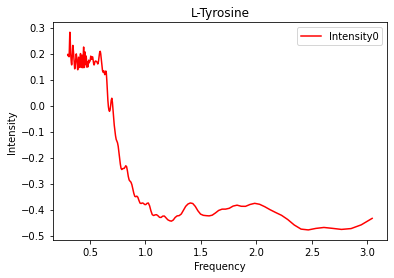

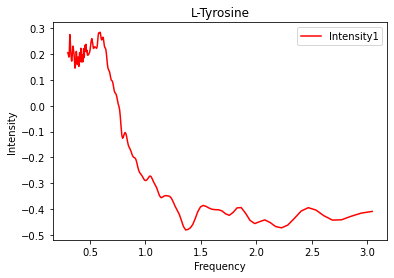

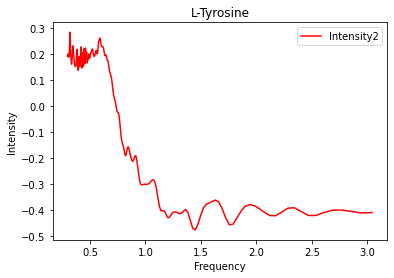

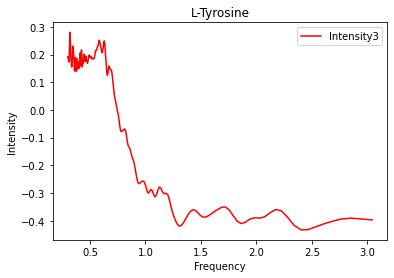

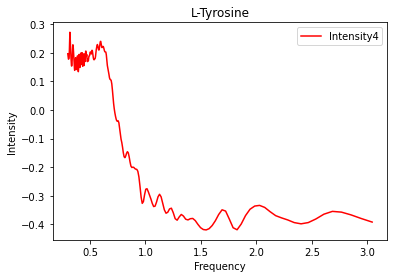

...

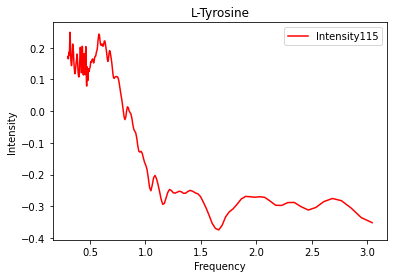

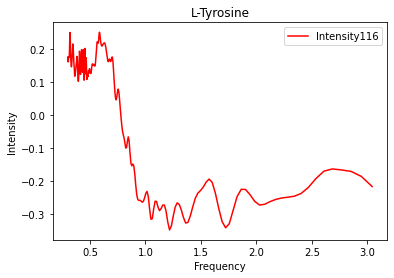

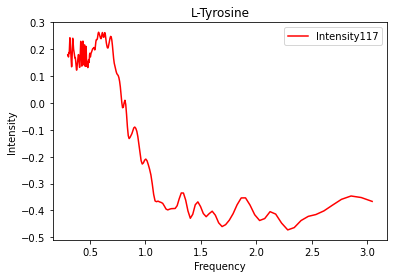

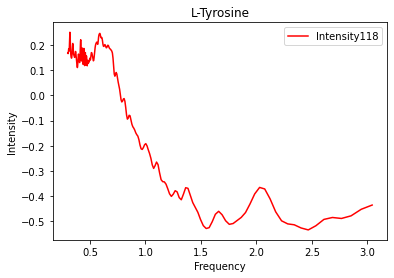

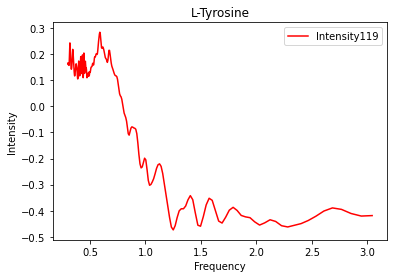

In [80]:
for i in range(0,120,1):
    df_L.plot('Frequency',f'Intensity{i}',c='r')
    plt.title('L-Tyrosine')
    plt.xlabel('Frequency')
    plt.ylabel('Intensity')